<a href="https://colab.research.google.com/github/Alexurm/Power-Generation-Projects/blob/main/GTE-170.1%20perfomances%20with%20evaporative%20type%20cooling%20system.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Информация об исследовании

**Расчет располагаемой мощности газовой турбины ГТЭ-170.1 с системой охлаждения 
воздуха в КВОУ испарительного типа**

---



Данное исследование охватывает вопросы изменения располагаемой мощности газовой турбины ГТЭ-170.1 в условиях работы в одном из южных регионов РФ в зависимости от температуры наружного воздуха и оценку эффекта от внедрения системы охлаждения воздуха в КВОУ ГТУ испарительного типа.  

ГТЭ-170.1 - это газотурбинная установка большой мощности производства «Силовых машин», имеющая требуемую степень локализации для участия в проектах модернизации тепловых электростанций с применением инновационных ГТУ отечественного производства.

Характеристики газовой машины (https://power-m.ru/customers/thermal-power/gas-turbines/):


*   Мощность на клеммах турбогенератора* - 155,3 МВт
*   КПД на клеммах турбогенератора* - 34,1%
*   Расход газов на выходе турбины - 509 кг/с
*   Температура на выходе турбины - 538 °С

**данные предоставлены в нормальных условиях по ГОСТ 52200-2004 (tн=+15 °С, рн=0,1013 МПа, относительная влажность 60 %)*

Большое влияние на работу и энергетические характеристики ГТУ оказывают климатические условия (температура, относительная влажность и давление наружного воздуха). Их изменения сказываются на экономичности, развиваемой электрической мощности, расходах рабочих сред и параметрах.  
Известно, что при повышении температуры наружного воздуха происходит снижение мощности ГТУ. Также изменение температуры воздуха, при постоянном объемном расходе, приводит к пропорциональному изменению массового расхода через турбины. Кроме того, из-за уменьшения воздуха уменьшается давление на выходе компрессора, что снижает потребляемую им мощность.  
Ощутимые потери мощности ГТУ на тепловых электростанциях связаны именно с высокой температурой наружного воздуха в летний период.  
Одним из способов решения данной проблемы является установка системы охлаждения испарительного типа. Входящий воздух проходит через охлаждающую среду (смачиваемые панели из целлюлозы), при этом вода испаряется и охлаждает воздух, подаваемый в турбину. В результате такого охлаждения образуется воздух повышенной плотности, который способствует увеличению выходной мощности турбины и эффективности сжигания топлива.

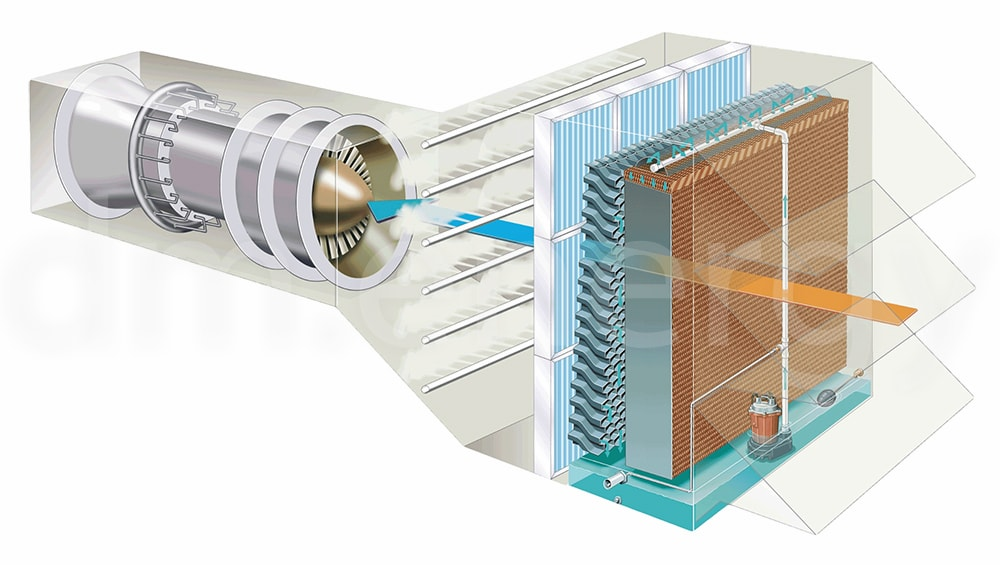

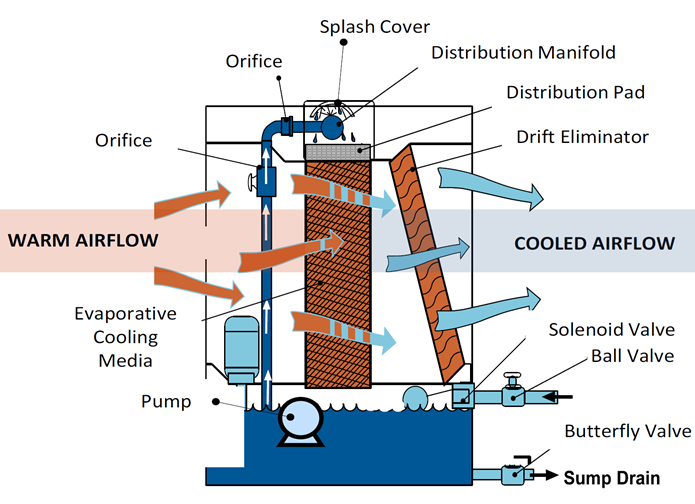

Температура после испарительной установки определяется по следующей формуле:
T2=T1-CE·(T1-Twb), где:  


*   T1 - температура воздуха перед испарительным охладителем, °С
*   T2 - температура воздуха за испарительным охладителем (перед компрессором ГТУ), °С
* Twb - температура влажного термометра, °С
* CE - эффективность насыщения (cooling efficiency), принимается равной 90%

**Принятые сокращения**

---

*   АСУ ТП - автоматизированная система управления технологическими процессами
*   ВНА - входной направляющий аппарат
*   ГТУ - газотурбинная установка
*   КВОУ - комплексное воздухоочистительная установка
*   КУ - котел-утилизатор
*   ПГУ - парогазовая установка  



*   EC - evaporative cooler (испарительный охладитель)
*   GT - gas turbine (газовая турбина)
*   HRSG - heat recovery steam generator (котел-утилизатор)
*   IRR - internal rate of return (внутренняя норма доходности)


**Принятые допущения**

---

Располагаемая мощность при 100% открытии ВНА рассчитывается с применением полиномов, которые получены при обработке результатов балансовых расчетов газовой турбины от «Силовых машин» конкретно для условий данного южного региона.
Поправки на влажность и давление для коррекции расчетов в данном исследовании не применяются (ГТУ уже рассчитана для средних значений указанных параметров, их влияние гораздо менее существенное, чем температура наружного воздуха).

**ВНА регулирует массовый расход воздуха в компрессор ГТУ, что в свою очередь влияет на расход топливного газа в камеру сгорания по скорректированной температуре за газовой турбиной и на электрическую мощность ГТУ соответственно. При 100% открытии ВНА мощность ГТУ является максимальной при соответствующих климатических условиях.*

Также, исходя из опыта эксплуатации, включение системы охлаждения воздуха испарительного типа при температуре наружного воздуха ниже 12 °С нецелесообразно (уставка применяется в алгоритме включения установки):

In [1]:
# задание уставки включения системы увлажнения
EC_set_point = 12

# Загрузка данных и их предобработка

In [2]:
# импорт необходимых библиотек:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px
from plotly import graph_objects as go

import datetime as dt

In [3]:
# подключение к Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Необходимо загрузить модуль на Python **wetairprops** для определения теплофизических свойств влажного воздуха и импортировать из модуля **calc_t_wb(t, RH, p=101325)** - расчёт температуры влажного термометра по температуре, относительной влажности и давлению воздуха:

In [4]:
import sys
sys.path.insert(0,"/content/drive/MyDrive/Colab Notebooks")

In [5]:
from wetairprops import calc_t_wb

Выполним проверку работоспособности модуля:

In [6]:
t = 30 # температура воздуха (сухой термометр), C
RH = 60 #относительная влажность, %
p = 101330 # пониженное атмосферное давление, Па

In [7]:
#Расчёт температуры влажного термометра (С) по температуре (С), относительной влажности ([0; 1]) и давлению воздуха (Па)
t_wb = calc_t_wb(t, RH/100, p)
round(t_wb, 2)

23.75

Модуль работает и выполняет адекватный расчет температуры влажного термометра, выполним загрузку архивных данных с метеостанции ПГУ тепловой электростанции: 

In [8]:
# чтение файла с данными и сохранение в df:
path = "/content/drive/MyDrive/Colab Notebooks/Данные/inlet_air_NGRES.csv"
df = pd.read_csv(path, sep=';', parse_dates=['date'], dayfirst=True, decimal=',')

In [9]:
# получение первых 10 строк таблицы df:
df.head(10) 

,date,temperature,humidity,pressure
0,2019-01-01 00:00:00,"0,416906089","88,15174866","982,0527344"
1,2019-01-01 00:30:00,"0,565306067","86,09046173","982,4733887"
2,2019-01-01 01:00:00,"0,550559103","84,63755798","983,0899658"
3,2019-01-01 01:30:00,"0,488031596","85,9716568","983,5992432"
4,2019-01-01 02:00:00,"-0,337018669","88,13065338","985,1000977"
5,2019-01-01 02:30:00,"-0,247874945","88,76753235","984,2467651"
6,2019-01-01 03:00:00,"-0,484688669","89,69736481","983,7794189"
7,2019-01-01 03:30:00,"0,204436228","88,89271545","985,5791016"
8,2019-01-01 04:00:00,"-0,049763534","87,8692627","986,9505615"
9,2019-01-01 04:30:00,"-0,352825582","89,27750397","985,2485352"


**Описание данных**

---


* `date` - дата и время записи параметров
* `temperature` - температура наружного воздуха, °С
* `humidity` - относительная влажность воздуха, %
* `pressure` - барометрическое давление, mbara

In [10]:
# получение общей информации о данных в таблице df:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68977 entries, 0 to 68976
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   date         68977 non-null  datetime64[ns]
 1   temperature  68977 non-null  object        
 2   humidity     68977 non-null  object        
 3   pressure     68977 non-null  object        
dtypes: datetime64[ns](1), object(3)
memory usage: 2.1+ MB


In [11]:
# получение общей информации о пропусках данных в таблице df:
df.isna().mean().sort_values(ascending=False)

date           0.0
temperature    0.0
humidity       0.0
pressure       0.0
dtype: float64

In [12]:
# переименуем столбцы для краткости
df.columns = ['date', 't1', 'RH', 'p']

Пропусков не наблюдается, названия столбцов переименованы. Прежде чем приводить тип данных к необходимому типу, рассмотрим имеющийся набор данных последовательно по столбцам:

In [13]:
df['t1'].sort_values()

53732    -0,000366519
21207    -0,000886836
15756    -0,001511198
19697    -0,001658145
792      -0,001739399
             ...     
48659      9,99825573
15115     9,998846054
66965     9,999241829
57930     9,999438286
46784       Bad Input
Name: t1, Length: 68977, dtype: object

In [14]:
df['RH'].sort_values()

26530    10,31865692
26531    10,69399548
53302    100,0002823
35100    100,0071564
15472    100,0074997
            ...     
21119    99,99689484
13933    99,99945831
36463    99,99987793
51856    99,99994659
46784      Bad Input
Name: RH, Length: 68977, dtype: object

In [15]:
df['p'].sort_values()

53286    906,5757446
53287    906,7207031
53289    906,9562378
53283    907,1538086
53288    907,3737793
            ...     
5994       Bad Input
5995       Bad Input
5996       Bad Input
5998       Bad Input
6000       Bad Input
Name: p, Length: 68977, dtype: object

Во всех рассматриваемых столбцах наблюдатся сигналы Bad Input, что бывает при записи в архив в АСУ ТП ПГУ. Необходимо избавиться от таких сигналов:

In [16]:
# удаление строк с "плохими" данными
df = df.query('t1 != "Bad Input" and RH != "Bad Input" and p != "Bad Input"').copy()

Заменим разделитель и поменяем тип данных в столбцах:

In [17]:
# замена разделителя
df['t1'] = [float(str(i).replace(",", ".")) for i in df['t1']]
df['RH'] = [float(str(i).replace(",", ".")) for i in df['RH']]
df['p'] = [float(str(i).replace(",", ".")) for i in df['p']]

In [18]:
# изменение типа данных
df['t1'] = df['t1'].astype('float64')
df['RH'] = df['RH'].astype('float64')
df['p'] = df['p'].astype('float64')

Рассмотрим средние значения и стандартные отклонения:

In [19]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
t1,68753.0,12.537439,10.033688,-16.409443,3.681386,12.481656,20.762487,37.956326
RH,68753.0,66.389545,20.908191,9.343907,51.383869,69.405640,84.250809,100.135277
p,68753.0,951.081703,17.292403,906.575745,936.049133,951.452393,966.380737,992.122986


Влажность не должна превышать 100%:

In [20]:
df = df.query('RH < 100').copy()

Также нецелесообразно в данном случае рассматривать температуру ниже минус 5 °С, так как включается в работу антиоблединительная система ГТУ и воздух подогревается до температуры не ниже минус 5 °С:

In [21]:
df = df.query('t1 >= -5').copy()

Рассмотрим еще раз общую информацию по таблице и выведем первые 5 строк:

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 67387 entries, 0 to 68976
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    67387 non-null  datetime64[ns]
 1   t1      67387 non-null  float64       
 2   RH      67387 non-null  float64       
 3   p       67387 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.6 MB


In [23]:
df.head()

,date,t1,RH,p
0,2019-01-01 00:00:00,0.416906,88.151749,982.052734
1,2019-01-01 00:30:00,0.565306,86.090462,982.473389
2,2019-01-01 01:00:00,0.550559,84.637558,983.089966
3,2019-01-01 01:30:00,0.488032,85.971657,983.599243
4,2019-01-01 02:00:00,-0.337019,88.130653,985.100098


Рассмотрим доступный временной интервал:

In [24]:
print(f'Данные доступны с {df["date"].dt.date.min()} по {df["date"].dt.date.max()}')

Данные доступны с 2019-01-01 по 2022-12-08


**Заключение**


---
Данные успешно загружены для дальнейшего анализа. Выполнена предобработка данных:


*   данные проверены на пропуски (отсутствуют);
*   сокращены наименования столбцов;
*   выполнена фильтрация датафрейма от плохих сигналов Bad Input;
*   выполнена замена десятичного разделителя и изменен тип данных в столбцах `t`, `RH`, `p` на `float64`;
*   выполнена фильтрация данных по условию "влажность не должна превышать 100%";
*   выполнена фильтрация данных по условия "температура наружного воздуха не ниже минус 5 °С.


# Выполнение расчетов

Напишем функцию которая будет принимать на вход данные по температуре наружного воздуха, его влажности и барометрическому давлению и вычислять температуру влажного термометра:

In [25]:
# функция для расчета температуры влажного термометра
def wet_bulb_temperature(row):
  t = row['t1']
  RH = row['RH'] / 100 # перевод процентов в доли
  p = row['p'] * 100 # перевод mbar в Па
  t_wb = calc_t_wb(t, RH, p)
  return(t_wb)

Применим функцию к датафрейму и рассмотрим данные:

In [26]:
df['t_wb'] = df.apply(wet_bulb_temperature, axis=1)

In [27]:
df.sort_values(by='t1')

,date,t1,RH,p,t_wb
877,2019-01-19 06:30:00,-4.999968,73.813065,984.263611,-6.087411
54351,2022-02-06 07:30:00,-4.995255,72.893890,931.905457,-6.163492
33906,2020-12-07 09:00:00,-4.995235,87.324730,956.496216,-5.527924
37275,2021-02-15 13:30:00,-4.994196,83.747658,944.094543,-5.684492
53394,2022-01-17 09:00:00,-4.988514,59.574432,935.742004,-6.739886
...,...,...,...,...,...
26576,2020-07-07 16:00:00,37.698429,14.847548,949.337036,18.389859
44717,2021-07-20 14:30:00,37.755489,22.310877,918.742859,20.667251
44722,2021-07-20 17:00:00,37.797386,18.661070,917.553711,19.520221
44768,2021-07-21 16:00:00,37.943722,22.602844,916.716003,20.870864


Напишем функцию для расчета температуры за системой охлаждения воздуха в КВОУ ГТУ, принимая во внимание алгоритм ее включения при t1 >= EC_set_point:

In [28]:
# эффективность испарителя
CE = 0.9

# функция для расчета температуры за испарителем
def cooled_air_temperature(row):
  t1 = row['t1']
  t_wb = row['t_wb']
  if t1 >= EC_set_point: # условие включения системы увлажнения
    t2 = t1 - CE * (t1 - t_wb)
  else:
    t2 = t1 # при выключенной системе увлажнения температура принимается равной наружной
  return(t2) 

Применим функцию и рассмотрим данные:

In [29]:
df['t2'] = df.apply(cooled_air_temperature, axis=1)

In [30]:
df.sample(10)

,date,t1,RH,p,t_wb,t2
51866,2021-12-16 13:00:00,4.530653,87.217842,931.889099,3.609843,4.530653
1332,2019-01-28 18:00:00,6.180831,80.014458,970.827209,4.662469,6.180831
32074,2020-10-30 05:00:00,10.945522,90.939446,955.722839,10.132050,10.945522
33521,2020-11-29 08:30:00,0.371144,98.664528,969.916992,0.293373,0.371144
17599,2020-01-02 15:30:00,2.629046,76.982018,970.538025,1.118355,2.629046
44054,2021-07-06 19:00:00,26.162407,50.462406,925.293579,18.640590,19.392771
38230,2021-03-07 11:00:00,-0.671747,60.300770,945.454346,-2.853896,-0.671747
25029,2020-06-05 10:30:00,23.009460,60.104908,959.297791,17.615467,18.154866
10103,2019-07-30 11:30:00,31.435831,28.719381,958.253296,18.342811,19.652113
51547,2021-12-09 21:30:00,9.125404,88.895370,933.233948,8.175964,9.125404


Напишем функцию для расчета мощности газовой турбины без системы увлажнения и с системой увлажнения:

In [31]:
def GT_power(row):
  # мощность ГТУ без системы увлажнения
  t1 = row['t1']
  GT_power_actual = (-0.0000410751777122353 * t1 ** 4 
                     + 0.00190558387543138 * t1 ** 3 
                     - 0.018940996355719 * t1 ** 2 
                     - 1.03090485433948 * t1 
                     + 157.193697254485)
  # мощность ГТУ с системой увлажнения
  t2 = row['t2']
  GT_power_with_EC = (-0.0000410751777122353 * t2 ** 4 
                      + 0.00190558387543138 * t2 ** 3 
                      - 0.018940996355719 * t2 ** 2 
                      - 1.03090485433948 * t2 
                      + 157.193697254485)
  return pd.Series([GT_power_actual, GT_power_with_EC])

Рассчитаем значения мощности ГТУ без системы увлажнения `GT_power_actual` и с системой увлажнения `GT_power_with_EC`:

In [32]:
df[['GT_power_actual', 'GT_power_with_EC']] = df.apply(GT_power, axis=1)

Газовая турбина планируется к работе с котлом-утилизатором, который будет вырабатывать пар для части ТЭЦ 130 ата (одноконтурный КУ с дожигающим устройством), напишем функцию для расчета его паропроизводительности в зависимости от температуры воздуха перед компрессором газовой турбины без системы увлажнения и с системой увлажнения:

In [33]:
def HRSG_capacity(row):
  # паропроизводительность КУ без системы увлажнения
  t1 = row['t1']
  HRSG_capacity_actual = (-0.00004196271211842630 * t1 ** 4 
                          + 0.00195836640044078000 * t1 ** 3 
                          - 0.02415464990641250000 * t1 ** 2 
                          - 1.18760855942491000000 * t1
                          + 323.22418768914200000000)
  # паропроизводительность КУ с системой увлажнения
  t2 = row['t2']
  HRSG_capacity_with_EC = (-0.00004196271211842630 * t2 ** 4 
                           + 0.00195836640044078000 * t2 ** 3 
                           - 0.02415464990641250000 * t2 ** 2 
                           - 1.18760855942491000000 * t2
                           + 323.22418768914200000000)
  return pd.Series([HRSG_capacity_actual, HRSG_capacity_with_EC])

Рассчитаем значения паропроизводительности КУ в т/ч без системы увлажнения `HRSG_capacity_actual` и с системой увлажнения `HRSG_capacity_with_EC`:

In [34]:
df[['HRSG_capacity_actual', 'HRSG_capacity_with_EC']] = df.apply(HRSG_capacity, axis=1)

Выведем несколько случайных значений из датафрейма:

In [35]:
df.sample(10)

,date,t1,RH,p,t_wb,t2,GT_power_actual,GT_power_with_EC,HRSG_capacity_actual,HRSG_capacity_with_EC
30532,2020-09-28 02:00:00,15.321876,75.256981,965.301453,12.711974,12.972964,141.542284,143.629160,304.088766,306.839395
5194,2019-04-19 05:00:00,2.976493,82.253860,972.295471,1.800639,2.976493,154.004435,154.004435,319.523630,319.523630
58300,2022-04-29 14:00:00,19.065241,50.353592,932.575134,12.815469,13.440446,138.433153,143.202546,299.829489,306.284236
48408,2021-10-05 12:00:00,9.482743,86.441055,941.055237,8.309208,9.482743,147.007448,147.007448,311.120965,311.120965
36452,2021-01-29 10:00:00,3.588170,84.884377,934.168274,2.539795,3.588170,153.331995,153.331995,318.735372,318.735372
5604,2019-04-27 18:00:00,22.725771,29.800524,969.731506,12.511517,13.532943,135.393036,143.118833,295.552440,306.174880
4247,2019-03-30 11:30:00,7.658694,32.306458,976.481995,1.890840,7.658694,148.902035,148.902035,313.447228,313.447228
56287,2022-03-18 15:30:00,-1.192173,61.912922,946.639709,-3.223791,-1.192173,158.392482,158.392482,324.602289,324.602289
26566,2020-07-07 11:00:00,34.040764,22.531237,946.971069,18.463712,20.021417,120.165412,137.654361,275.710437,298.738495
2529,2019-02-22 16:30:00,4.067550,71.548691,974.351440,2.073249,4.067550,152.804059,152.804059,318.114199,318.114199


Выделим столбец с днем года:

In [36]:
df['day_of_year'] = df['date'].dt.dayofyear

In [37]:
df[df['day_of_year']==100]

,date,t1,RH,p,t_wb,t2,GT_power_actual,GT_power_with_EC,HRSG_capacity_actual,HRSG_capacity_with_EC,day_of_year
4752,2019-04-10 00:00:00,12.446036,66.952553,964.193359,9.218111,9.540903,144.117227,146.948392,307.470228,311.047682,100
4753,2019-04-10 00:30:00,12.063191,67.428085,964.427918,8.925612,9.239370,144.476715,147.255527,307.932027,311.428269,100
4754,2019-04-10 01:00:00,10.817892,71.057701,963.781433,8.162009,10.817892,145.674777,145.674777,309.454594,309.454594,100
4755,2019-04-10 01:30:00,11.668395,69.340416,962.220886,8.760666,11.668395,144.851770,144.851770,308.411335,308.411335,100
4756,2019-04-10 02:00:00,10.901432,72.642029,964.781311,8.390805,10.901432,145.593032,145.593032,309.351477,309.351477,100
...,...,...,...,...,...,...,...,...,...,...,...
57403,2022-04-10 21:30:00,14.386389,57.086979,924.123230,9.753622,10.216899,142.356949,146.268614,305.173122,310.200473,100
57404,2022-04-10 22:00:00,13.975144,57.987652,923.907715,9.506877,9.953704,142.721742,146.531815,305.654235,310.529315,100
57405,2022-04-10 22:30:00,13.696487,59.996284,924.529785,9.497366,9.917278,142.971376,146.568391,305.981912,310.574930,100
57406,2022-04-10 23:00:00,13.836943,59.888886,926.492737,9.610222,10.032894,142.845297,146.452425,305.816575,310.430235,100


Рассчитаем средние значения климатических параметров за каждый день года в доступном периоде:

In [38]:
profile = (df.groupby('day_of_year')
          .agg({'t1': 'mean', 'RH': 'mean', 'p': 'mean'})
          .reset_index()
          )

Применим последовательно функции для расчета температуры влажного термометра, температуры воздуха за системой увлажнения, расчета максимальной располагаемой мощности турбины и паропроизводительности котла-утилизатора:

In [39]:
# расчет средней дневной температуры влажного термометра
profile['t_wb'] = profile.apply(wet_bulb_temperature, axis=1)

# расчет средней дневной температуры воздуха перед компрессором ГТУ (за охладителем)
profile['t2'] = profile.apply(cooled_air_temperature, axis=1)

# расчет осредненной мощности ГТУ без системы увлажнения и с системой увлажнения
profile[['GT_power_actual', 'GT_power_with_EC']] = profile.apply(GT_power, axis=1)

# расчет осредненной паропроизводительности КУ без системы увлажнения и с системой увлажнения
profile[['HRSG_capacity_actual', 'HRSG_capacity_with_EC']] = profile.apply(HRSG_capacity, axis=1)

Рассмотрим получившуюся таблицу средних дневных значений:

In [40]:
profile.sample(10)

,day_of_year,t1,RH,p,t_wb,t2,GT_power_actual,GT_power_with_EC,HRSG_capacity_actual,HRSG_capacity_with_EC
171,172,24.562519,51.602962,946.598827,17.566561,18.266157,133.732453,139.084338,293.227547,300.735787
341,342,1.468577,81.489725,948.974502,0.304978,1.468577,155.644728,155.644728,321.434006,321.434006
215,216,24.987163,52.825078,943.613323,18.114633,18.801886,133.325185,138.647520,292.662382,300.128514
138,139,17.640124,61.008884,951.123190,13.078906,13.535028,139.597215,143.116949,301.444872,306.172416
20,21,-0.448549,78.176483,960.393366,-1.632897,-0.448549,157.652124,157.652124,323.751850,323.751850
150,151,22.662832,55.194021,951.135148,16.560856,17.171054,135.447585,139.984092,295.629225,301.976665
212,213,26.103430,48.157791,942.166389,18.229313,19.016725,132.200362,138.472636,291.114568,299.884611
115,116,14.531150,55.613491,948.816647,9.757166,10.234564,142.229539,146.251016,305.004441,310.178449
76,77,2.783654,75.356014,956.144643,1.138846,2.783654,154.215883,154.215883,319.770851,319.770851
101,102,10.314623,72.267539,946.748666,7.798545,10.314623,146.171371,146.171371,310.078711,310.078711


**Заключение**

---
Для выполнения расчетов и дальнейшего анализа данных написаны и применены следующие функции:

*   `wet_bulb_temperature` - принимает на вход данные по температуре наружного воздуха, его влажности и барометрическому давлению и вычисляет температуру влажного термометра;
*   `cooled_air_temperature` - принимает на вход данные по температуре наружного воздуха, температуре влажного термометра и по заданной эффективности увлажнения вычисляет температуру охлажденного воздуха перед компрессором ГТУ (при этом также выполняется условие включения системы увлажнения по уставке `EC_set_point`);
*   `GT_power` - принимает на вход температуру наружного воздуха и температуру за системой увлажнения и вычисляет два значения электрической мощности ГТУ (без системы увлажнения и с системой увлажнения) по полиномам 4 степени;
*   `HRSG_capacity` - принимает на вход температуру наружного воздуха и температуру за системой увлажнения и вычисляет два значения паропроизводительности котла-утилизатора (без системы увлажнения и с системой увлажнения) по полиномам 4 степени.

Также для последующего анализа эффективности за годовой период в датафрейме `df` выделен день года из даты, выполнена группировка и осреденение климатических параметров по дням года, данные собраны в отдельный датафрейм `profile`.  
К полученным данным применены перечисленные выше функции, что позволило получить осредненные суточные показатели мощности ГТУ и паропроизводительности КУ без установки системы увлажнения и с ее установкой.


# Построение графиков

Рассмотрим теоретическую электическую нагрузку ГТЭ-170.1 за весь доступный период времени без системы увлажнения (красная линия) и с системой увлажнения (синяя прерывистая линия):

In [41]:
fig1 = px.scatter(df, x="date", y="GT_power_actual", trendline="lowess", trendline_options=dict(frac=0.05))
fig1.data[1].line.color = 'red'
fig1.update_traces(marker=dict(color='white'), marker_size=0.1)

fig2 = px.scatter(df, x="date", y="GT_power_with_EC", trendline="lowess", trendline_options=dict(frac=0.05))
fig2.data[1].line.color = '#6495ED'
fig2.update_traces(line=dict(dash="dash", width=2), marker=dict(color='white'), marker_size=0.1)

fig = go.Figure(data = fig1.data + fig2.data)
fig.update_layout(title='Электрическая нагрузка ГТЭ-170.1 по времени при открытии ВНА на 100%', title_x=0.5, template='plotly_white')

fig.update_yaxes(title_text='Электрическая нагрузка, МВт')

fig.show()

Из графика можно сделать вывод о том, что установка системы охлаждения испарительного типа может существенно повысить среднюю располагаемую мощность газовой турбины в теплый период времени и тем самым значительно увеличить выработку электрической энергии.

Рассмотрим зависимость паропроизводительности котла-утилизатора за весь доступный период времени без системы увлажнения (красная линия) и с системой увлажнения (синяя прерывистая линия)

In [42]:
fig1 = px.scatter(df, x="date", y="HRSG_capacity_actual", trendline="lowess", trendline_options=dict(frac=0.05))
fig1.data[1].line.color = 'red'
fig1.update_traces(marker=dict(color='white'), marker_size=0.1)

fig2 = px.scatter(df, x="date", y="HRSG_capacity_with_EC", trendline="lowess", trendline_options=dict(frac=0.05))
fig2.data[1].line.color = '#6495ED'
fig2.update_traces(line=dict(dash="dash", width=2), marker=dict(color='white'), marker_size=0.1)

fig = go.Figure(data = fig1.data + fig2.data)
fig.update_layout(title='Паропроизводительность котла-утилизатора по времени при открытии ВНА на 100%', title_x=0.5, template='plotly_white')

fig.update_yaxes(title_text='Паропроизводительность, т/ч')

fig.show()

Характер изменения паропроизводительности котла-утилизатора повторяет предыдущую зависимость для мощности газовой турбины. Это объясняется тем, что чем выше мощность ГТУ, тем больше расход газов выхлопных газов за ней и тепло, поступающее в котел-утилизатор, соответственно. Паропроизводительность котла-утилизатора в свою очередь однозначным образом зависит от располагаемого тепла от уходящих газов ГТУ.
Коэффициент корреляции между паропроизводительностью котла-утилизатора и мощностью ГТУ:

In [43]:
# коэффициенты корреляции:
df[['HRSG_capacity_actual', 'GT_power_actual']].corr()

,HRSG_capacity_actual,GT_power_actual
HRSG_capacity_actual,1.000000,0.999374
GT_power_actual,0.999374,1.000000


Коэффициент корреляции между этими двумя параметрами фактически равен единице (зависимость сильная весьма высокая согласно шкале Чеддока)

Применение системы увлажнения позволяет существенно сгладить график паропроизводительности котла-утилизатора, частично нивелировав влияние высоких температур наружного воздуха в теплый период года.

Рассмотрим осредненные суточные показатели по газовой турбине без системы увлажнения (красная линия) и с системой увлажнения (синяя прерывистая линия):

In [44]:
fig1 = px.scatter(profile, x="day_of_year", y="GT_power_actual", trendline="lowess", trendline_options=dict(frac=0.1), 
                 labels={"power_total": "Электрическая нагрузка, МВт", "day_of_year": ""})
fig1.data[1].line.color = 'red'
fig1.update_traces(marker=dict(color='white'), marker_size=1)

fig2 = px.scatter(profile, x="day_of_year", y="GT_power_with_EC", trendline="lowess", trendline_options=dict(frac=0.1),
                 labels={"power_total": "Электрическая нагрузка, МВт", "day_of_year": ""})

fig2.data[1].line.color = '#6495ED'
fig2.update_traces(line=dict(dash="dash", width=2), marker=dict(color='white'), marker_size=1)

fig = go.Figure(data = fig1.data + fig2.data)
fig.update_layout(title='Среднесуточная электрическая нагрузка ГТУ при открытии ВНА на 100%, МВт', title_x=0.5, template='plotly_white')

fig.update_xaxes(range=[1, 366], tickvals=np.linspace(1,366,13)[:-1], ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
fig.update_yaxes(title_text='Электрическая нагрузка, МВт')

fig.show()

Из графика следует, что система увлажнения воздуха в КВОУ в условиях данного южного региона РФ позволяет существенно повысить располагаемую мощность ГТУ в период с апреля по конец октября. В остальное время данная система будет в простое, т.к. не выполняется условие ее включения по принятой уставке.  
Рассмотрим осредненные суточные показатели по котлу-утилизатору без системы увлажнения (красная линия) и с системой увлажнения (синяя прерывистая линия):

In [45]:
fig1 = px.scatter(profile, x="day_of_year", y="HRSG_capacity_actual", trendline="lowess", trendline_options=dict(frac=0.1), 
                 labels={"power_total": "Паропроизводительность, т/ч", "day_of_year": ""})
fig1.data[1].line.color = 'red'
fig1.update_traces(marker=dict(color='white'), marker_size=1)

fig2 = px.scatter(profile, x="day_of_year", y="HRSG_capacity_with_EC", trendline="lowess", trendline_options=dict(frac=0.1),
                 labels={"power_total": "Паропроизводительность, т/ч", "day_of_year": ""})

fig2.data[1].line.color = '#6495ED'
fig2.update_traces(line=dict(dash="dash", width=2), marker=dict(color='white'), marker_size=1)

fig = go.Figure(data = fig1.data + fig2.data)
fig.update_layout(title='Среднесуточная паропроизводительность котла-утилизатора при открытии ВНА на 100%, т/ч', title_x=0.5, template='plotly_white')

fig.update_xaxes(range=[1, 366], tickvals=np.linspace(1,366,13)[:-1], ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
fig.update_yaxes(title_text='Паропроизводительность, т/ч')

fig.show()

Паропроизводительность котла-утилизатора также становится выше в теплый период времени за счет повышения располагаемой мощности ГТУ.

**Заключение**

---

Выполнено графическое отображение результатов расчетов. Отмечено, что применение системы охлаждения испарительного типа может существенно повысить среднюю располагаемую мощность газовой турбины в теплый период времени и тем самым значительно увеличить выработку электрической энергии, а также позволяет существенно сгладить график паропроизводительности котла-утилизатора, частично нивелировав влияние высоких температур наружного воздуха в теплый период года.  
Анализ осредненных суточных значений показал, что работа системы увлажнения в конкретных климатических условиях данного южного региона РФ обоснована в период с апреля по конец октября.

# Анализ эффективности системы увлажнения

Дополним датафрейм `profile` разницей между мощностью ГТУ с установленной системой увлажнения и без нее в абсолютных и относительных величинах:

In [46]:
# абсолютная разница мощности ГТУ в МВт
profile['GT_power_diff_abs'] = profile['GT_power_with_EC'] - profile['GT_power_actual']

# относительная разница мощности ГТУ
profile['GT_power_diff_rv'] = profile['GT_power_with_EC'] / profile['GT_power_actual'] - 1

Также дополним датафрейм `profile` абсолютной разницей между паропроизводительностью котла-утилизатора с учетом системы увлажнения и без нее для дальнейшей оценки тепловых балансов всей части ТЭЦ 130 ата:

In [47]:
# абсолютная разница паропроизводительности КУ в т/ч
profile['HRSG_capacity_diff_abs'] = profile['HRSG_capacity_with_EC'] - profile['HRSG_capacity_actual']

Построим график абсолютного изменения располагаемой среднесуточной мощности:

In [48]:
fig = px.bar(profile, x='day_of_year', y='GT_power_diff_abs', 
             labels={ "GT_power_diff_abs": "Изменение мощности ГТУ, МВт", "day_of_year": ""},
             title='Прирост мощности ГТУ при установке системы увлажнения, МВт',
             color='GT_power_diff_abs')

fig.update_xaxes(range=[1, 366], tickvals=np.linspace(1,366,13)[:-1], ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
fig.update_traces(textfont_size=12, textangle=0, textposition="outside")
    
fig.update_layout(showlegend=False, title_x=0.5, template='plotly_white')
fig.show() 

Также рассмотрим относительное изменение располагаемой среднесуточной мощности:

In [49]:
fig = px.bar(profile, x='day_of_year', y='GT_power_diff_rv', 
             labels={ "GT_power_diff_rv": "Изменение мощности ГТУ", "day_of_year": ""},
             title='Прирост мощности ГТУ при установке системы увлажнения, %',
             color='GT_power_diff_rv')

fig.update_xaxes(range=[1, 366], tickvals=np.linspace(1,366,13)[:-1], ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
fig.update_traces(textfont_size=12, textangle=0, textposition="outside")
    
fig.layout.yaxis.tickformat = ',.0%' 
fig.update_layout(showlegend=False, title_x=0.5, template='plotly_white')
fig.show() 

Исходя из полученных результатов, прирост мощности в теплый период времени составит от 1,5 до 5% или от 2 до 6,5 МВт соответственно, при этом пик дополнительной мощности приходится на самые жаркие месяцы. Рассмотрим среднее значение прироста мощности при работающей системе увлажнения:

In [50]:
print(f'Абсолютный средний прирост мощности ГТУ - {round(profile.query("t1 >= @EC_set_point")["GT_power_diff_abs"].mean(), 2)} МВт')
print(f'Относительный средний прирост мощности ГТУ - {round(profile.query("t1 >= @EC_set_point")["GT_power_diff_rv"].mean(), 2):.1%}')

Абсолютный средний прирост мощности ГТУ - 4.23 МВт
Относительный средний прирост мощности ГТУ - 3.0%


Рассмотрим изменение среднесуточной паропроизводительности котла-утилизатора: 

In [51]:
fig = px.bar(profile, x='day_of_year', y='HRSG_capacity_diff_abs', 
             labels={ "HRSG_capacity_diff_abs": "Изменение паропроизводительности КУ, т/ч", "day_of_year": ""},
             title='Прирост паропроизводительности КУ при установке системы увлажнения, МВт',
             color='HRSG_capacity_diff_abs')

fig.update_xaxes(range=[1, 366], tickvals=np.linspace(1,366,13)[:-1], ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
fig.update_traces(textfont_size=12, textangle=0, textposition="outside")
    
fig.update_layout(showlegend=False, title_x=0.5, template='plotly_white')
fig.show() 

Изменение паропроизводительности котла-утилизатора при включенной системе увлажнения составит от 3 до 9 т/ч, что позволит направить больше пара в обший коллектор 130 ата ТЭЦ для выработки электрической и тепловой энергии. Если принять, что паровая турбина типа ПТ-80/100 согласно балансовым расчетам расходует порядка 305 т/ч острого пара в голову  и ее мощность составляет 80 МВт в чистом конденсационном режиме, то примерное соотношение между расходом пара и дополнительной выработкой электрической энергии паровых турбин ТЭЦ составит порядка 3,8. Таким образом, увеличение паропроизводительности котла-утилизатора обеспечит дополнительный прирост мощности от 0,8 до 2,4 МВт на паросиловой части ТЭЦ.
Рассмотрим среднее значение прироста мощности при работающей системе увлажнения:

In [52]:
print(f'Абсолютный средний прирост паропроизводительности КУ - {round(profile.query("t1 >= @EC_set_point")["HRSG_capacity_diff_abs"].mean(), 2)} т/ч')
print(f'Средний прирост мощности ПТ-80/100 в конденсационном режиме - {round(profile.query("t1 >= @EC_set_point")["HRSG_capacity_diff_abs"].mean() / 3.8, 2)} МВт')

Абсолютный средний прирост паропроизводительности КУ - 5.81 т/ч
Средний прирост мощности ПТ-80/100 в конденсационном режиме - 1.53 МВт


**Заключение**

---
Рассчитаны абсолютные и относительные значения прироста располагаемой мощности ГТУ при установке системы увлажнения по данным из датафрейма `profile`. Исходя из полученных результатов, прирост мощности в теплый период времени составит от 1,5 до 5% или от 2 до 6,5 МВт соответственно, при этом пик дополнительной мощности приходится на самые жаркие месяцы. Абсолютный средний прирост мощности ГТУ - 4.23 МВт, относительный средний прирост мощности ГТУ - 3.0%.  
Увеличение паропроизводительности котла-утилизатора составит от 3 до 9 т/ч при работающей системе увлажнения (коррелирует с мощностью ГТУ). Выполнена оценка прироста мощности паровой турбины типа ПТ-80/100 в конденсационном режиме, увеличение составит от 0,8 до 2,4 МВт, в среднем - 1,53 МВт.

Полученные результаты исследования могут использоваться далее в финансовой модели для оценки IRR инвестпроекта по установке системы охлаждения воздуха в КВОУ ГТУ испарительного типа с учетом планируемой загрузки генерирующего оборудования ТЭЦ.

# Общий вывод

Данные успешно загружены для дальнейшего анализа. Выполнена предобработка данных:

*   данные проверены на пропуски (отсутствуют);
*   сокращены наименования столбцов;
*   выполнена фильтрация датафрейма от плохих сигналов Bad Input;
*   выполнена замена десятичного разделителя и изменен тип данных в столбцах `t`, `RH`, `p` на `float64`;
*   выполнена фильтрация данных по условию "влажность не должна превышать 100%";
*   выполнена фильтрация данных по условию "температура наружного воздуха не ниже минус 5 °С.

Архивные данные с метеостанции ПГУ доступны с 2019-01-01 по 2022-12-08 с интервалом 30 минут.

Для выполнения расчетов и дальнейшего анализа данных написаны и применены следующие функции:

*   `wet_bulb_temperature` - принимает на вход данные по температуре наружного воздуха, его влажности и барометрическому давлению и вычисляет температуру влажного термометра;
*   `cooled_air_temperature` - принимает на вход данные по температуре наружного воздуха, температуре влажного термометра и по заданной эффективности увлажнения вычисляет температуру охлажденного воздуха перед компрессором ГТУ (при этом также выполняется условие включения системы увлажнения по уставке `EC_set_point`);
*   `GT_power` - принимает на вход температуру наружного воздуха и температуру за системой увлажнения и вычисляет два значения электрической мощности ГТУ (без системы увлажнения и с системой увлажнения) по полиномам 4 степени;
*   `HRSG_capacity` - принимает на вход температуру наружного воздуха и температуру за системой увлажнения и вычисляет два значения паропроизводительности котла-утилизатора (без системы увлажнения и с системой увлажнения) по полиномам 4 степени.

Также для последующего анализа эффективности за годовой период в датафрейме `df` выделен день года из даты, выполнена группировка и осреденение климатических параметров по дням года, данные собраны в отдельный датафрейм `profile`.  
К полученным данным применены перечисленные выше функции, что позволило получить осредненные суточные показатели мощности ГТУ и паропроизводительности КУ без установки системы увлажнения и с ее установкой.

Выполнено графическое отображение результатов расчетов. Отмечено, что применение системы охлаждения испарительного типа может существенно повысить среднюю располагаемую мощность газовой турбины в теплый период времени и тем самым значительно увеличить выработку электрической энергии, а также позволяет существенно сгладить график паропроизводительности котла-утилизатора, частично нивелировав влияние высоких температур наружного воздуха в теплый период года.
Анализ осредненных суточных значений показал, что работа системы увлажнения в конкретных климатических условиях данного южного региона РФ обоснована в период с апреля по конец октября.

Помимо этого, для удобства сравнения располагаемой мощности газовой турбины и паропроизводительности котла-утилизатора при установке системы охлаждения данные из датафрейма `df` загружены в Tableu Public для создания дашборда.  
Дашборд имеет фильтр по дате, что позволяет оценить перечисленные параметры в интересующем историческом срезе и доступен по адресу:  
https://public.tableau.com/views/GTE-170_1EC/GTE-170_1perfomanceswithEC?:language=en-US&:display_count=n&:origin=viz_share_link

Анализ данных по дашборду на примере исторических данных за июль 2020 г. показывает, что помимо увеличения располагаемой мощности ГТУ в целом применение системы увлажнения нивелирует также суточные колебания температуры наружного воздуха, график нагрузки ГТУ практически выравнивается.

Рассчитаны абсолютные и относительные значения прироста располагаемой мощности ГТУ при установке системы увлажнения по данным из датафрейма `profile`. Исходя из полученных результатов, прирост мощности в теплый период времени составит от 1,5 до 5% или от 2 до 6,5 МВт соответственно, при этом пик дополнительной мощности приходится на самые жаркие месяцы. Абсолютный средний прирост мощности ГТУ - 4.23 МВт, относительный средний прирост мощности ГТУ - 3.0%.  
Увеличение паропроизводительности котла-утилизатора составит от 3 до 9 т/ч при работающей системе увлажнения (коррелирует с мощностью ГТУ). Выполнена оценка прироста мощности паровой турбины типа ПТ-80/100 в конденсационном режиме, увеличение составит от 0,8 до 2,4 МВт, в среднем - 1,53 МВт.

Полученные результаты исследования могут использоваться далее в финансовой модели для оценки IRR инвестпроекта по установке системы охлаждения воздуха в КВОУ ГТУ испарительного типа с учетом планируемой загрузки генерирующего оборудования ТЭЦ.

In [53]:
# выгрузка данных 
#df.to_csv('data.csv')
#!cp data.csv "drive/My Drive/"